<div style="background-color: rgba(238, 238, 238, 0.6); padding: 10px; margin-left: 80%"><span style="display: block; color: black; font-size: 24px; text-align: right; font-weight: bold; text-shadow: 2px 2px 4px #999999;">Integrated CA<br><br></span><span style="display: block; color: black; text-align: right; font-weight: bold; text-shadow: 2px 2px 4px #999999;">Zygimantas Jakubauskas<br></span></div>

<span style="color: blue;">

## Table of contents:
</span>

* [Introduction](#first-bullet)
** [Data dictionary](#eight-bullet)    
* [1. Exploratory data analysis](#second-bullet)
* [2. Data preparation](#fourth-bullet)    
* [3. Content and Collaborative filtering](#twelwth-bullet)   
** [3.1. Collaborative FIltering](#fifth-bullet)   
** [3.2. Content Filtering](#third-bullet)     
* [4. Time Series Analysis](#12th-bullet) 
** [4.1. Augmented Dickey Fuller Test](#sixth-bullet)    
** [4.2. ARIMA Model](#tenth-bullet)  
** [4.3. One step ahead forecast](#14th-bullet)     
* [5. Visualisations](#seventh-bullet)  
** [5.1. Data Preparation for Visualisations](#11th-bullet) 
** [5.2. Visualisations used for Dashboard](#16th-bullet)     
* [6. Dashboard](#15th-bullet)    
* [References](#13th-bullet)  

In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

import warnings
warnings.filterwarnings("ignore")

from sklearn.metrics.pairwise import cosine_similarity
from sklearn.metrics import mean_absolute_error, mean_squared_error
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.arima.model import ARIMA
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

import plotly.graph_objs as go
import plotly.express as px
import folium
import ipywidgets as widgets
from ipywidgets import interact, Layout
import altair as alt
alt.data_transformers.enable("default", max_rows=None)
import plotly.express as px
import ipywidgets as widgets
import panel as pn
pn.extension("vega", template="fast")
from sklearn import datasets, linear_model
from sklearn.metrics import r2_score
from folium import plugins
from bokeh.plotting import figure, show, output_notebook
from bokeh.models import ColumnDataSource, HoverTool
from bokeh.palettes import Category20
import holoviews as hv
from holoviews import opts
from holoviews.streams import Selection1D

<span style="color: blue;">

## Introduction <a class="anchor" id="first-bullet"></a>

</span>

Dataset used for this analysis is publicly available on Kaggle.

<span style="color: blue;">

###  Data dictionary <a class="anchor" id="eight-bullet"></a>

</span>

__Date__ - Date when purchase was made.

__Day__ - Day of the purchase.

__Month__ - Month of the purchase.

__Year__ - Year of the purchase.

__Customer_Age__ - Age of the customer.

__Age_Group__ - Age group to where customer belongs. There are 4 groups - Youth, Young adult, Adult and Senior.

__Customer_Gender__ - Gender of the customer.

__Country__ - Country from which order was made.

__State__ - State of the country.

__Product_Category__ - Product category.

__Sub_Category__ - Products sub-category.

__Product__ - Product purchased.

__Order_Quantity__ - Quantity.

__Unit_Cost__ - Cost of the unit to the seller.

__Unit_Price__ - Selling price.

__Profit__ - Profit.

__Cost__ - Total cost to the seller.

__Revenue__ - Revenue, calculated as Profit + Cost.

<span style="color: blue;">

## 1. Exploratory Data Analysis <a class="anchor" id="second-bullet"></a>

</span>

Reading the daatset and displaying the header.

In [2]:
df = pd.read_csv("Sales.csv")

In [3]:
pd.set_option('display.max_columns', None)

In [4]:
df.head()

,Date,Day,Month,Year,Customer_Age,Age_Group,Customer_Gender,Country,State,Product_Category,Sub_Category,Product,Order_Quantity,Unit_Cost,Unit_Price,Profit,Cost,Revenue
0,2013-11-26,26,November,2013,19,Youth (<25),M,Canada,British Columbia,Accessories,Bike Racks,Hitch Rack - 4-Bike,8,45,120,590,360,950
1,2015-11-26,26,November,2015,19,Youth (<25),M,Canada,British Columbia,Accessories,Bike Racks,Hitch Rack - 4-Bike,8,45,120,590,360,950
2,2014-03-23,23,March,2014,49,Adults (35-64),M,Australia,New South Wales,Accessories,Bike Racks,Hitch Rack - 4-Bike,23,45,120,1366,1035,2401
3,2016-03-23,23,March,2016,49,Adults (35-64),M,Australia,New South Wales,Accessories,Bike Racks,Hitch Rack - 4-Bike,20,45,120,1188,900,2088
4,2014-05-15,15,May,2014,47,Adults (35-64),F,Australia,New South Wales,Accessories,Bike Racks,Hitch Rack - 4-Bike,4,45,120,238,180,418


In [5]:
df.shape

(113036, 18)

Looking into data types and value counts of different variables, that will be used for further analysis.

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 113036 entries, 0 to 113035
Data columns (total 18 columns):
 #   Column            Non-Null Count   Dtype 
---  ------            --------------   ----- 
 0   Date              113036 non-null  object
 1   Day               113036 non-null  int64 
 2   Month             113036 non-null  object
 3   Year              113036 non-null  int64 
 4   Customer_Age      113036 non-null  int64 
 5   Age_Group         113036 non-null  object
 6   Customer_Gender   113036 non-null  object
 7   Country           113036 non-null  object
 8   State             113036 non-null  object
 9   Product_Category  113036 non-null  object
 10  Sub_Category      113036 non-null  object
 11  Product           113036 non-null  object
 12  Order_Quantity    113036 non-null  int64 
 13  Unit_Cost         113036 non-null  int64 
 14  Unit_Price        113036 non-null  int64 
 15  Profit            113036 non-null  int64 
 16  Cost              113036 non-null  int

In [7]:
df["Country"].value_counts()

United States     39206
Australia         23936
Canada            14178
United Kingdom    13620
Germany           11098
France            10998
Name: Country, dtype: int64

In [8]:
df["Sub_Category"].value_counts()

Tires and Tubes      33870
Bottles and Cages    15876
Road Bikes           13430
Helmets              12158
Mountain Bikes        8854
Jerseys               6010
Caps                  4358
Fenders               4032
Touring Bikes         3698
Gloves                2686
Cleaners              1802
Shorts                1794
Hydration Packs       1334
Socks                 1122
Vests                  964
Bike Racks             592
Bike Stands            456
Name: Sub_Category, dtype: int64

In [9]:
df["Age_Group"].value_counts()

Adults (35-64)          55824
Young Adults (25-34)    38654
Youth (<25)             17828
Seniors (64+)             730
Name: Age_Group, dtype: int64

In [10]:
df["Product"].value_counts()

Water Bottle - 30 oz.      10794
Patch Kit/8 Patches        10416
Mountain Tire Tube          6816
AWC Logo Cap                4358
Sport-100 Helmet, Red       4220
                           ...  
Mountain-100 Silver, 48       58
Mountain-100 Silver, 42       54
Mountain-500 Silver, 48       40
Road-650 Red, 52              32
Mountain-500 Black, 52        22
Name: Product, Length: 130, dtype: int64

In [11]:
df.describe(include="all")

,Date,Day,Month,Year,Customer_Age,Age_Group,Customer_Gender,Country,State,Product_Category,Sub_Category,Product,Order_Quantity,Unit_Cost,Unit_Price,Profit,Cost,Revenue
count,113036,113036.000000,113036,113036.000000,113036.000000,113036,113036,113036,113036,113036,113036,113036,113036.000000,113036.000000,113036.000000,113036.000000,113036.000000,113036.000000
unique,1884,NaN,12,NaN,NaN,4,2,6,53,3,17,130,NaN,NaN,NaN,NaN,NaN,NaN
top,2016-03-01,NaN,June,NaN,NaN,Adults (35-64),M,United States,California,Accessories,Tires and Tubes,Water Bottle - 30 oz.,NaN,NaN,NaN,NaN,NaN,NaN
freq,288,NaN,11234,NaN,NaN,55824,58312,39206,22450,70120,33870,10794,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,15.665753,NaN,2014.401739,35.919212,NaN,NaN,NaN,NaN,NaN,NaN,NaN,11.901660,267.296366,452.938427,285.051665,469.318695,754.370360
std,NaN,8.781567,NaN,1.272510,11.021936,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9.561857,549.835483,922.071219,453.887443,884.866118,1309.094674
min,NaN,1.000000,NaN,2011.000000,17.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.000000,1.000000,2.000000,-30.000000,1.000000,2.000000
25%,NaN,8.000000,NaN,2013.000000,28.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.000000,2.000000,5.000000,29.000000,28.000000,63.000000
50%,NaN,16.000000,NaN,2014.000000,35.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10.000000,9.000000,24.000000,101.000000,108.000000,223.000000
75%,NaN,23.000000,NaN,2016.000000,43.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,20.000000,42.000000,70.000000,358.000000,432.000000,800.000000


Checking for duplicates and missing values.

In [12]:
df.duplicated().value_counts()

False    112036
True       1000
dtype: int64

In [13]:
df.isnull().sum()

Date                0
Day                 0
Month               0
Year                0
Customer_Age        0
Age_Group           0
Customer_Gender     0
Country             0
State               0
Product_Category    0
Sub_Category        0
Product             0
Order_Quantity      0
Unit_Cost           0
Unit_Price          0
Profit              0
Cost                0
Revenue             0
dtype: int64

Getting the numbers of unique values.

In [14]:
df.nunique()

Date                1884
Day                   31
Month                 12
Year                   6
Customer_Age          70
Age_Group              4
Customer_Gender        2
Country                6
State                 53
Product_Category       3
Sub_Category          17
Product              130
Order_Quantity        32
Unit_Cost             34
Unit_Price            36
Profit              1256
Cost                 360
Revenue             1876
dtype: int64

Plotting the variables.

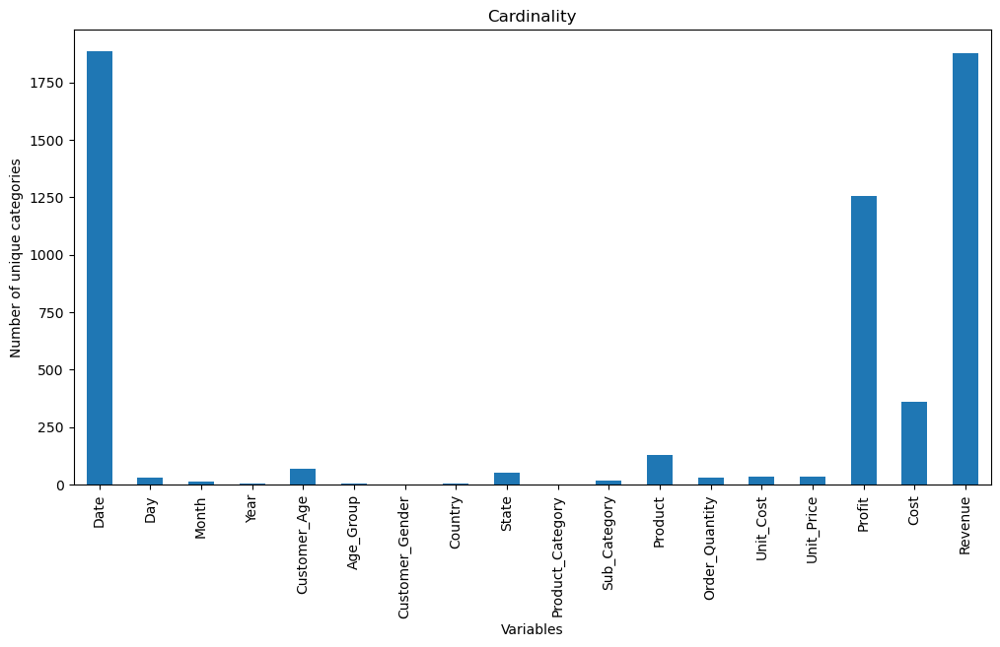

In [15]:
df.nunique().plot.bar(figsize=(12,6))
plt.ylabel("Number of unique categories")
plt.xlabel("Variables")
plt.title("Cardinality");

Histogramms of categorical variables.

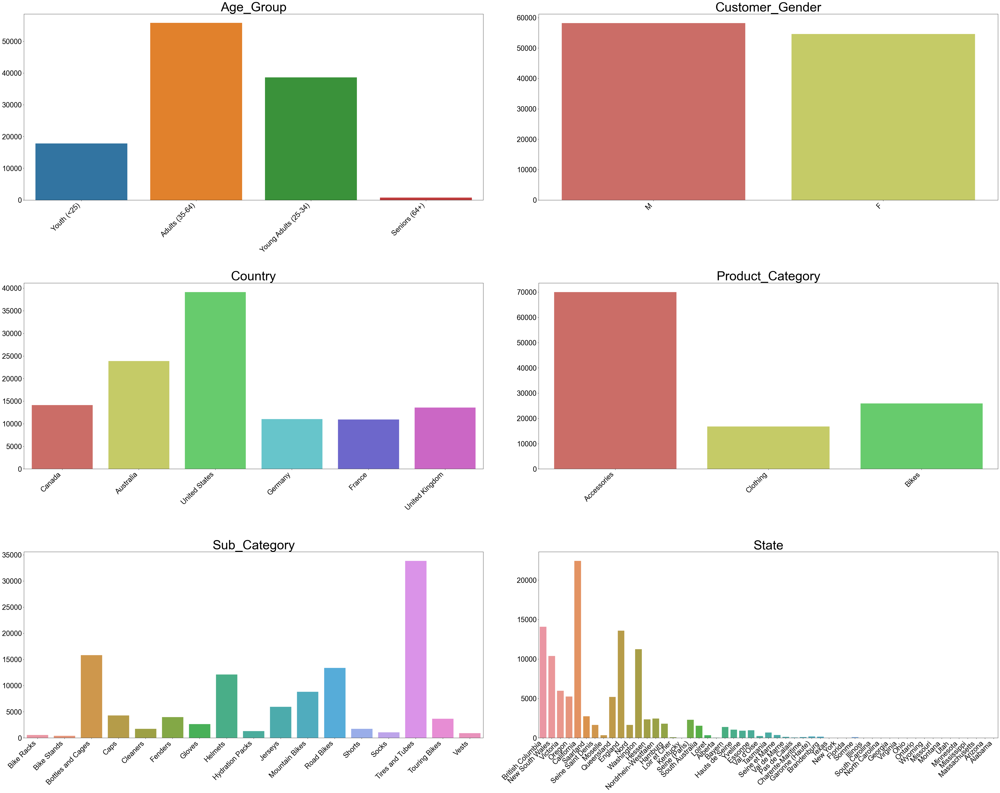

In [16]:
fig, axs = plt.subplots(nrows=3, ncols=2, figsize=(50, 40))
axs = axs.flatten()
for i, col in enumerate(["Age_Group", "Customer_Gender", "Country", "Product_Category", "Sub_Category", "State"]):
    sns.countplot(x=col, data=df, ax=axs[i])
    axs[i].set_xlabel("")
    axs[i].set_ylabel("")
    axs[i].set_xticklabels(df[col].unique(), rotation=45, ha="right", size=25)
    axs[i].tick_params(axis="x", labelsize=25)  
    axs[i].tick_params(axis="y", labelsize=25)  
    axs[i].set_title(f"{col}", fontsize=45)
    sns.set(style="darkgrid", palette="hls")

plt.tight_layout(pad=5)    
plt.show()

Scatterplot of numerical data.

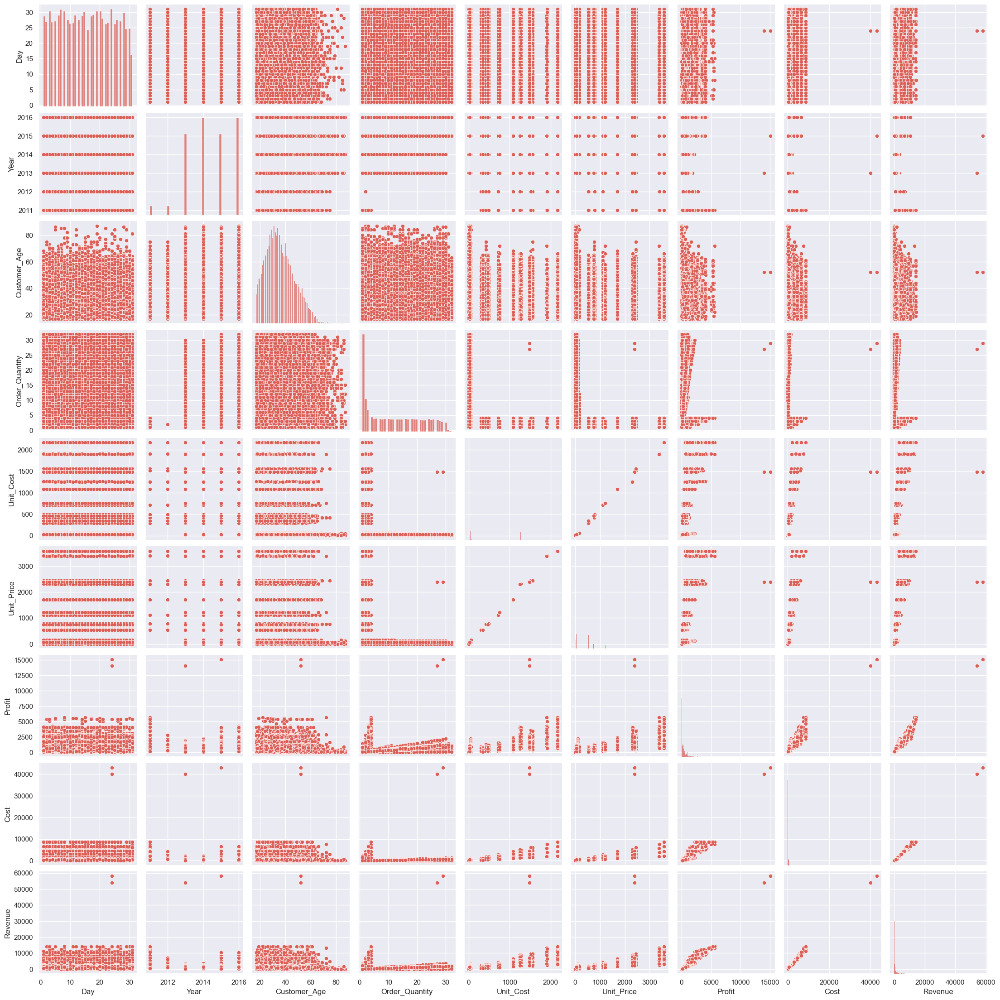

In [17]:
sns.pairplot(df, kind="scatter")

Plotting corelation heatmap.

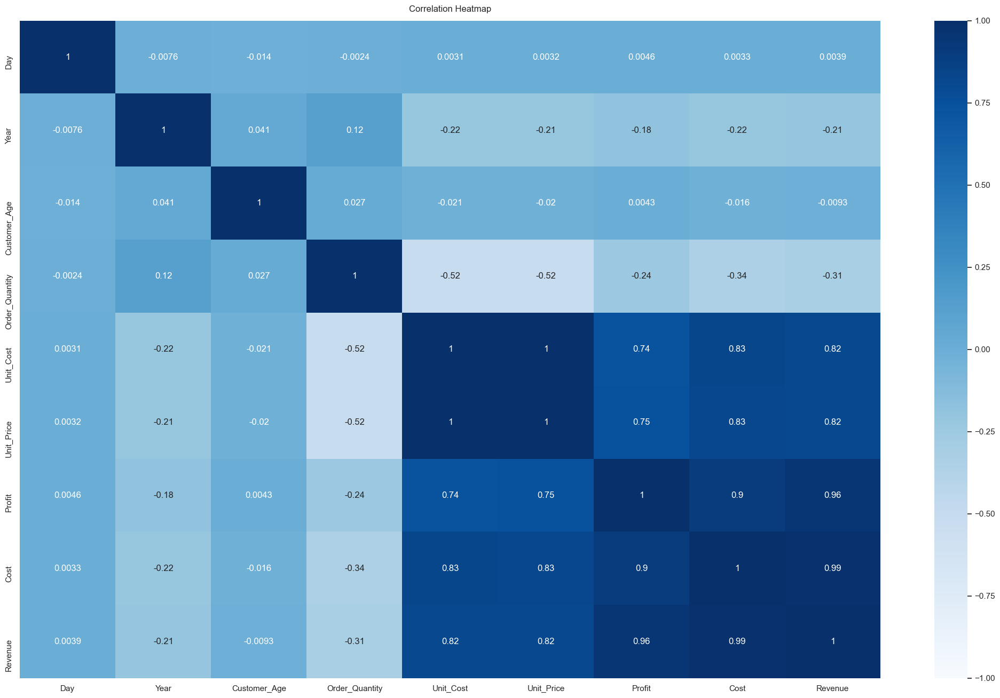

In [18]:
plt.figure(figsize=(26, 16))
heatmap = sns.heatmap(df.corr(), vmin=-1, vmax=1, cmap="Blues", annot=True)
heatmap.set_title("Correlation Heatmap", fontdict={"fontsize":12}, pad=12);

<span style="color: blue;">

## 2. Data preparation <a class="anchor" id="fourth-bullet"></a>

</span>

In [19]:
df = df.drop_duplicates()

In [20]:
df.shape

(112036, 18)

In [21]:
df.head()

,Date,Day,Month,Year,Customer_Age,Age_Group,Customer_Gender,Country,State,Product_Category,Sub_Category,Product,Order_Quantity,Unit_Cost,Unit_Price,Profit,Cost,Revenue
0,2013-11-26,26,November,2013,19,Youth (<25),M,Canada,British Columbia,Accessories,Bike Racks,Hitch Rack - 4-Bike,8,45,120,590,360,950
1,2015-11-26,26,November,2015,19,Youth (<25),M,Canada,British Columbia,Accessories,Bike Racks,Hitch Rack - 4-Bike,8,45,120,590,360,950
2,2014-03-23,23,March,2014,49,Adults (35-64),M,Australia,New South Wales,Accessories,Bike Racks,Hitch Rack - 4-Bike,23,45,120,1366,1035,2401
3,2016-03-23,23,March,2016,49,Adults (35-64),M,Australia,New South Wales,Accessories,Bike Racks,Hitch Rack - 4-Bike,20,45,120,1188,900,2088
4,2014-05-15,15,May,2014,47,Adults (35-64),F,Australia,New South Wales,Accessories,Bike Racks,Hitch Rack - 4-Bike,4,45,120,238,180,418


Renaming columns for easier understanding.

In [22]:
df = df.rename(columns={"Customer_Age": "Age", "Customer_Gender": "Gender", "Product_Category": "Category", 
                       "Order_Quantity": "Quantity", "Unit_Cost": "Cost_Price", "Unit_Price": "Selling_Price"})
df.head()

,Date,Day,Month,Year,Age,Age_Group,Gender,Country,State,Category,Sub_Category,Product,Quantity,Cost_Price,Selling_Price,Profit,Cost,Revenue
0,2013-11-26,26,November,2013,19,Youth (<25),M,Canada,British Columbia,Accessories,Bike Racks,Hitch Rack - 4-Bike,8,45,120,590,360,950
1,2015-11-26,26,November,2015,19,Youth (<25),M,Canada,British Columbia,Accessories,Bike Racks,Hitch Rack - 4-Bike,8,45,120,590,360,950
2,2014-03-23,23,March,2014,49,Adults (35-64),M,Australia,New South Wales,Accessories,Bike Racks,Hitch Rack - 4-Bike,23,45,120,1366,1035,2401
3,2016-03-23,23,March,2016,49,Adults (35-64),M,Australia,New South Wales,Accessories,Bike Racks,Hitch Rack - 4-Bike,20,45,120,1188,900,2088
4,2014-05-15,15,May,2014,47,Adults (35-64),F,Australia,New South Wales,Accessories,Bike Racks,Hitch Rack - 4-Bike,4,45,120,238,180,418


<span style="color: blue;">

## 3. Content and Collaborative filtering <a class="anchor" id="twelwth-bullet"></a>

</span>

Creating new variable "InvoiceID", based on customers that bought on the same day and have matching attributes such as "Age", "Gender", "State" and "Country".

In [23]:
df.sort_values(by="Date", inplace=True)

In [24]:
invoiceID = 123456

parameters = None

for index, row in df.iterrows():
    if parameters == (row["Day"], row["Month"], row["Year"], row["Age"], row["Gender"], row["State"], row["Country"]):
        df.at[index, "InvoiceID"] = invoiceID
    else:
        invoiceID += 1
        df.at[index, "InvoiceID"] = invoiceID
        parameters = (row["Day"], row["Month"], row["Year"], row["Age"], row["Gender"], row["State"], row["Country"])

df.head()

,Date,Day,Month,Year,Age,Age_Group,Gender,Country,State,Category,Sub_Category,Product,Quantity,Cost_Price,Selling_Price,Profit,Cost,Revenue,InvoiceID
58729,2011-01-01,1,January,2011,33,Young Adults (25-34),F,France,Yveline,Bikes,Road Bikes,"Road-150 Red, 48",2,2171,3578,1097,4342,5439,123457.0
49787,2011-01-01,1,January,2011,23,Youth (<25),M,Australia,Victoria,Bikes,Mountain Bikes,"Mountain-200 Black, 46",1,1252,2295,561,1252,1813,123458.0
58913,2011-01-01,1,January,2011,17,Youth (<25),M,Canada,British Columbia,Bikes,Road Bikes,"Road-250 Red, 44",1,1519,2443,900,1519,2419,123459.0
63711,2011-01-01,1,January,2011,39,Adults (35-64),M,United States,Washington,Bikes,Road Bikes,"Road-550-W Yellow, 38",3,713,1120,482,2139,2621,123460.0
60993,2011-01-01,1,January,2011,42,Adults (35-64),M,United States,California,Bikes,Road Bikes,"Road-750 Black, 44",1,344,540,185,344,529,123461.0


Creating new variable "CustomerID", based on customers who have matching attributes such as "Age", "Gender", "State" and "Country". Inaccuracies expected as there could be in fact different people who have same attributes and this is taken into account.

In [25]:
df.sort_values(by=["Age", "Gender", "State", "Country"], inplace=True)

customerID = 234567

customers = {}

for index, row in df.iterrows():
    customer_data = (row["Age"], row["Gender"], row["State"], row["Country"])
    
    if customer_data in customers:
        df.at[index, "CustomerID"] = customers[customer_data]
    else:
        customerID += 1
        df.at[index, "CustomerID"] = customerID
        customers[customer_data] = customerID
df.head()

,Date,Day,Month,Year,Age,Age_Group,Gender,Country,State,Category,Sub_Category,Product,Quantity,Cost_Price,Selling_Price,Profit,Cost,Revenue,InvoiceID,CustomerID
11808,2013-10-22,22,October,2013,17,Youth (<25),F,Germany,Bayern,Accessories,Bottles and Cages,Water Bottle - 30 oz.,1,2,5,3,2,5,141709.0,234568.0
37818,2013-10-22,22,October,2013,17,Youth (<25),F,Germany,Bayern,Accessories,Helmets,"Sport-100 Helmet, Black",18,13,35,390,234,624,141778.0,234568.0
11809,2015-10-22,22,October,2015,17,Youth (<25),F,Germany,Bayern,Accessories,Bottles and Cages,Water Bottle - 30 oz.,1,2,5,3,2,5,192232.0,234568.0
37819,2015-10-22,22,October,2015,17,Youth (<25),F,Germany,Bayern,Accessories,Helmets,"Sport-100 Helmet, Black",18,13,35,390,234,624,192278.0,234568.0
88562,2013-12-31,31,December,2013,17,Youth (<25),F,Germany,Brandenburg,Accessories,Tires and Tubes,Patch Kit/8 Patches,13,1,2,13,13,26,151629.0,234569.0


Changing type of newly created variables from float to integer.

In [26]:
df["InvoiceID"] = df["InvoiceID"].astype(int)
df["CustomerID"] = df["CustomerID"].astype(int)

Resetting index.

In [27]:
df = df.reset_index(drop=True)

In [28]:
df.head()

,Date,Day,Month,Year,Age,Age_Group,Gender,Country,State,Category,Sub_Category,Product,Quantity,Cost_Price,Selling_Price,Profit,Cost,Revenue,InvoiceID,CustomerID
0,2013-10-22,22,October,2013,17,Youth (<25),F,Germany,Bayern,Accessories,Bottles and Cages,Water Bottle - 30 oz.,1,2,5,3,2,5,141709,234568
1,2013-10-22,22,October,2013,17,Youth (<25),F,Germany,Bayern,Accessories,Helmets,"Sport-100 Helmet, Black",18,13,35,390,234,624,141778,234568
2,2015-10-22,22,October,2015,17,Youth (<25),F,Germany,Bayern,Accessories,Bottles and Cages,Water Bottle - 30 oz.,1,2,5,3,2,5,192232,234568
3,2015-10-22,22,October,2015,17,Youth (<25),F,Germany,Bayern,Accessories,Helmets,"Sport-100 Helmet, Black",18,13,35,390,234,624,192278,234568
4,2013-12-31,31,December,2013,17,Youth (<25),F,Germany,Brandenburg,Accessories,Tires and Tubes,Patch Kit/8 Patches,13,1,2,13,13,26,151629,234569


Reorganising columns for better readibility of the dataset.

In [29]:
columns = ["Date", "Day", "Month", "Year", "CustomerID", "InvoiceID", "Age", "Age_Group", "Gender", "Country", "State",
                       "Category", "Sub_Category", "Product", "Quantity", "Cost_Price", "Selling_Price", "Cost", "Revenue", "Profit"]
df = df[columns]

In [30]:
df.head()

,Date,Day,Month,Year,CustomerID,InvoiceID,Age,Age_Group,Gender,Country,State,Category,Sub_Category,Product,Quantity,Cost_Price,Selling_Price,Cost,Revenue,Profit
0,2013-10-22,22,October,2013,234568,141709,17,Youth (<25),F,Germany,Bayern,Accessories,Bottles and Cages,Water Bottle - 30 oz.,1,2,5,2,5,3
1,2013-10-22,22,October,2013,234568,141778,17,Youth (<25),F,Germany,Bayern,Accessories,Helmets,"Sport-100 Helmet, Black",18,13,35,234,624,390
2,2015-10-22,22,October,2015,234568,192232,17,Youth (<25),F,Germany,Bayern,Accessories,Bottles and Cages,Water Bottle - 30 oz.,1,2,5,2,5,3
3,2015-10-22,22,October,2015,234568,192278,17,Youth (<25),F,Germany,Bayern,Accessories,Helmets,"Sport-100 Helmet, Black",18,13,35,234,624,390
4,2013-12-31,31,December,2013,234569,151629,17,Youth (<25),F,Germany,Brandenburg,Accessories,Tires and Tubes,Patch Kit/8 Patches,13,1,2,13,26,13


In [31]:
pivot_df = df.pivot_table(
    index="CustomerID", 
    columns="Product", 
    values="Quantity",
    aggfunc="sum")

In [32]:
pivot_df.shape

(2162, 130)

In [33]:
pivot_df = pivot_df.applymap(lambda x: 1 if x > 0 else 0)

In [34]:
pivot_df.head()

Product,AWC Logo Cap,All-Purpose Bike Stand,Bike Wash - Dissolver,"Classic Vest, L","Classic Vest, M","Classic Vest, S",Fender Set - Mountain,HL Mountain Tire,HL Road Tire,"Half-Finger Gloves, L","Half-Finger Gloves, M","Half-Finger Gloves, S",Hitch Rack - 4-Bike,Hydration Pack - 70 oz.,LL Mountain Tire,LL Road Tire,"Long-Sleeve Logo Jersey, L","Long-Sleeve Logo Jersey, M","Long-Sleeve Logo Jersey, S","Long-Sleeve Logo Jersey, XL",ML Mountain Tire,ML Road Tire,Mountain Bottle Cage,Mountain Tire Tube,"Mountain-100 Black, 38","Mountain-100 Black, 42","Mountain-100 Black, 44","Mountain-100 Black, 48","Mountain-100 Silver, 38","Mountain-100 Silver, 42","Mountain-100 Silver, 44","Mountain-100 Silver, 48","Mountain-200 Black, 38","Mountain-200 Black, 42","Mountain-200 Black, 46","Mountain-200 Silver, 38","Mountain-200 Silver, 42","Mountain-200 Silver, 46","Mountain-400-W Silver, 38","Mountain-400-W Silver, 40","Mountain-400-W Silver, 42","Mountain-400-W Silver, 46","Mountain-500 Black, 40","Mountain-500 Black, 42","Mountain-500 Black, 44","Mountain-500 Black, 48","Mountain-500 Black, 52","Mountain-500 Silver, 40","Mountain-500 Silver, 42","Mountain-500 Silver, 44","Mountain-500 Silver, 48","Mountain-500 Silver, 52",Patch Kit/8 Patches,"Racing Socks, L","Racing Socks, M",Road Bottle Cage,Road Tire Tube,"Road-150 Red, 44","Road-150 Red, 48","Road-150 Red, 52","Road-150 Red, 56","Road-150 Red, 62","Road-250 Black, 44","Road-250 Black, 48","Road-250 Black, 52","Road-250 Black, 58","Road-250 Red, 44","Road-250 Red, 48","Road-250 Red, 52","Road-250 Red, 58","Road-350-W Yellow, 40","Road-350-W Yellow, 42","Road-350-W Yellow, 44","Road-350-W Yellow, 48","Road-550-W Yellow, 38","Road-550-W Yellow, 40","Road-550-W Yellow, 42","Road-550-W Yellow, 44","Road-550-W Yellow, 48","Road-650 Black, 44","Road-650 Black, 48","Road-650 Black, 52","Road-650 Black, 58","Road-650 Black, 60","Road-650 Black, 62","Road-650 Red, 44","Road-650 Red, 48","Road-650 Red, 52","Road-650 Red, 58","Road-650 Red, 60","Road-650 Red, 62","Road-750 Black, 44","Road-750 Black, 48","Road-750 Black, 52","Road-750 Black, 58","Short-Sleeve Classic Jersey, L","Short-Sleeve Classic Jersey, M","Short-Sleeve Classic Jersey, S","Short-Sleeve Classic Jersey, XL","Sport-100 Helmet, Black","Sport-100 Helmet, Blue","Sport-100 Helmet, Red",Touring Tire,Touring Tire Tube,"Touring-1000 Blue, 46","Touring-1000 Blue, 50","Touring-1000 Blue, 54","Touring-1000 Blue, 60","Touring-1000 Yellow, 46","Touring-1000 Yellow, 50","Touring-1000 Yellow, 54","Touring-1000 Yellow, 60","Touring-2000 Blue, 46","Touring-2000 Blue, 50","Touring-2000 Blue, 54","Touring-2000 Blue, 60","Touring-3000 Blue, 44","Touring-3000 Blue, 50","Touring-3000 Blue, 54","Touring-3000 Blue, 58","Touring-3000 Blue, 62","Touring-3000 Yellow, 44","Touring-3000 Yellow, 50","Touring-3000 Yellow, 54","Touring-3000 Yellow, 58","Touring-3000 Yellow, 62",Water Bottle - 30 oz.,"Women's Mountain Shorts, L","Women's Mountain Shorts, M","Women's Mountain Shorts, S"
CustomerID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
234568,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0
234569,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
234570,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0
234571,1,0,1,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0

<span style="color: blue;">

### 3.1. Collaborative FIltering <a class="anchor" id="fifth-bullet"></a>

</span>

New matrix is created using cosine similarity.

In [35]:
user_to_user_matrix = pd.DataFrame(
    cosine_similarity(pivot_df))

In [36]:
user_to_user_matrix.head()

0        1         2         3         4         5     6         7     \
0  1.000000  0.00000  0.267261  0.000000  0.267261  0.000000   0.0  0.000000   
1  0.000000  1.00000  0.000000  0.277350  0.000000  0.000000   0.0  0.000000   
2  0.267261  0.00000  1.000000  0.209657  0.285714  0.000000   0.0  0.188982   
3  0.000000  0.27735  0.209657  1.000000  0.209657  0.196116   0.0  0.138675   
4  0.267261  0.00000  0.285714  0.209657  1.000000  0.000000   0.0  0.000000   

       8     9        10       11        12    13        14        15    \
0  0.408248   0.5  0.00000  0.00000  0.250000   0.0  0.408248  0.316228   
1  0.000000   0.0  1.00000  1.00000  0.000000   0.0  0.000000  0.000000   
2  0.000000   0.0  0.00000  0.00000  0.267261   0.0  0.218218  0.169031   
3  0.160128   0.0  0.27735  0.27735  0.196116   0.0  0.000000  0.000000   
4  0.000000   0.0  0.00000  0.00000  0.400892   0.0  0.218218  0.338062   

       16    17        18        19    20    21        22        23    24    \
0  0.316228   0.0  0.000000  0.316228   0.0   0.0  0.235702  0.000000   0.0   
1  0.000000   0.0  0.500000  0.447214   0.0   0.0  0.000000  0.000000   0.0   
2  0.338062   0.0  0.188982  0.338062   0.0   0.0  0.377964  0.436436   0.0   
3  0.124035   0.0  0.277350  0.372104   0.0   0.0  0.277350  0.160128   0.0   
4  0.338062   0.0  0.000000  0.169031   0.0   0.0  0.377964  0.000000   0.0   

       25        26        27        28        29        30        31    \
0  0.000000  0.447214  0.196116  0.223607  0.000000  0.000000  0.000000   
1  0.500000  0.000000  0.000000  0.000000  0.447214  0.000000  0.000000   
2  0.188982  0.239046  0.524142  0.478091  0.169031  0.000000  0.000000   
3  0.277350  0.263117  0.384615  0.350823  0.372104  0.196116  0.196116   
4  0.000000  0.239046  0.209657  0.478091  0.000000  0.000000  0.000000   

      32        33        34        35       36        37        38    \
0  0.00000  0.000000  0.500000  0.392232  0.00000  0.000000  0.471405   
1  1.00000  0.000000  0.000000  0.000000  0.50000  0.000000  0.333333   
2  0.00000  0.377964  0.267261  0.314485  0.00000  0.169031  0.251976   
3  0.27735  0.000000  0.000000  0.153846  0.27735  0.248069  0.277350   
4  0.00000  0.000000  0.267261  0.104828  0.00000  0.169031  0.251976   

       39        40        41    42        43        44        45        46    \
0  0.000000  0.000000  0.000000   0.0  0.000000  0.500000  0.223607  0.000000   
1  0.447214  0.447214  0.000000   0.0  0.000000  0.000000  0.316228  0.267261   
2  0.169031  0.169031  0.000000   0.0  0.000000  0.267261  0.000000  0.303046   
3  0.248069  0.372104  0.248069   0.0  0.000000  0.196116  0.526235  0.518875   
4  0.169031  0.169031  0.169031   0.0  0.188982  0.000000  0.000000  0.202031   

   47    48        49        50        51    52        53        54    \
0   0.0   0.0  0.213201  0.000000  0.235702   0.0  0.000000  0.000000   
1   0.0   0.0  0.000000  0.000000  0.000000   0.0  0.000000  0.000000   
2   0.0   0.0  0.455842  0.327327  0.377964   0.0  0.000000  0.154303   
3   0.0   0.0  0.418121  0.320256  0.277350   0.0  0.000000  0.113228   
4   0.0   0.0  0.341882  0.109109  0.125988   0.0  0.218218  0.154303   

       55        56        57       58        59        60        61    62    \
0  0.000000  0.447214  0.316228  0.00000  0.250000  0.250000  0.471405   0.0   
1  0.000000  0.000000  0.000000  0.00000  0.000000  0.000000  0.000000   0.0   
2  0.000000  0.239046  0.338062  0.00000  0.400892  0.133631  0.377964   0.0   
3  0.196116  0.175412  0.124035  0.27735  0.196116  0.000000  0.277350   0.0   
4  0.534522  0.239046  0.169031  0.00000  0.267261  0.133631  0.251976   0.0   

       63        64        65        66        67        68        69    \
0  0.000000  0.353553  0.000000  0.204124  0.353553  0.250000  0.188982   
1  0.000000  0.000000  0.353553  0.000000  0.000000  0.000000  0.000000   
2  0.338062  0.188982  0.267261  0.327327  0.188982  0.267261  0.303046   
3  

Reindexing new matrix and renaming columns.

In [37]:
user_to_user_matrix.columns = pivot_df.index
user_to_user_matrix["CustomerID"] = pivot_df.index
user_to_user_matrix = user_to_user_matrix.set_index("CustomerID")

In [38]:
user_to_user_matrix.head()

CustomerID    234568   234569    234570    234571    234572    234573  234574  \
CustomerID                                                                      
234568      1.000000  0.00000  0.267261  0.000000  0.267261  0.000000     0.0   
234569      0.000000  1.00000  0.000000  0.277350  0.000000  0.000000     0.0   
234570      0.267261  0.00000  1.000000  0.209657  0.285714  0.000000     0.0   
234571      0.000000  0.27735  0.209657  1.000000  0.209657  0.196116     0.0   
234572      0.267261  0.00000  0.285714  0.209657  1.000000  0.000000     0.0   

CustomerID    234575    234576  234577   234578   234579    234580  234581  \
CustomerID                                                                   
234568      0.000000  0.408248     0.5  0.00000  0.00000  0.250000     0.0   
234569      0.000000  0.000000     0.0  1.00000  1.00000  0.000000     0.0   
234570      0.188982  0.000000     0.0  0.00000  0.00000  0.267261     0.0   
234571      0.138675  0.160128     0.0  0.27735  0.27735  0.196116     0.0   
234572      0.000000  0.000000     0.0  0.00000  0.00000  0.400892     0.0   

CustomerID    234582    234583    234584  234585    234586    234587  234588  \
CustomerID                                                                     
234568      0.408248  0.316228  0.316228     0.0  0.000000  0.316228     0.0   
234569      0.000000  0.000000  0.000000     0.0  0.500000  0.447214     0.0   
234570      0.218218  0.169031  0.338062     0.0  0.188982  0.338062     0.0   
234571      0.000000  0.000000  0.124035     0.0  0.277350  0.372104     0.0   
234572      0.218218  0.338062  0.338062     0.0  0.000000  0.169031     0.0   

CustomerID  234589    234590    234591  234592    234593    234594    234595  \
CustomerID                                                                     
234568         0.0  0.235702  0.000000     0.0  0.000000  0.447214  0.196116   
234569         0.0  0.000000  0.000000     0.0  0.500000  0.000000  0.000000   
234570         0.0  0.377964  0.436436     0.0  0.188982  0.239046  0.524142   
234571         0.0  0.277350  0.160128     0.0  0.277350  0.263117  0.384615   
234572         0.0  0.377964  0.000000     0.0  0.000000  0.239046  0.209657   

CustomerID    234596    234597    234598    234599   234600    234601  \
CustomerID                                                              
234568      0.223607  0.000000  0.000000  0.000000  0.00000  0.000000   
234569      0.000000  0.447214  0.000000  0.000000  1.00000  0.000000   
234570      0.478091  0.169031  0.000000  0.000000  0.00000  0.377964   
234571      0.350823  0.372104  0.196116  0.196116  0.27735  0.000000   
234572      0.478091  0.000000  0.000000  0.000000  0.00000  0.000000   

CustomerID    234602    234603   234604    234605    234606    234607  \
CustomerID                                                              
234568      0.500000  0.392232  0.00000  0.000000  0.471405  0.000000   
234569      0.000000  0.000000  0.50000  0.000000  0.333333  0.447214   
234570      0.267261  0.314485  0.00000  0.169031  0.251976  0.169031   
234571      0.000000  0.153846  0.27735  0.248069  0.277350  0.248069   
234572      0.267261  0.104828  0.00000  0.169031  0.251976  0.169031   

CustomerID    234608    234609  234610    234611    234612    234613  \
CustomerID                                                             
234568      0.000000  0.000000     0.0  0.000000  0.500000  0.223607   
234569      0.447214  0.000000     0.0  0.000000  0.000000  0.316228   
234570      0.169031  0.000000     0.0  0.000000  0.267261  0.000000   
234571      0.372104  0.248069     0.0  0.000000  0.196116  0.526235   
234572      0.169031  0.169031     0.0  0.188982  0.000000  0.000000   

CustomerID    234614  234615  234616    234617    234618    234619  234620  \
CustomerID                                                                   
234568      0.000000     0.0     0.0  0.213201  0.000000  0.235702     0.0   


Finding the top customer.

In [39]:
revenue_by_customer = df.groupby("CustomerID")["Revenue"].sum().reset_index()

top_customers = revenue_by_customer.sort_values(by="Revenue", ascending=False)

top_customers.head(1)

,CustomerID,Revenue
575,235143,538009


Finding customers that bought most unique items.

In [40]:
unique = df.groupby("CustomerID")["Product"].nunique().reset_index()

unique.columns = ["CustomerID", "UniqueProductsCount"]

most_uniq_products = unique.sort_values(by="UniqueProductsCount", ascending=False)

most_uniq_products.head(1)

,CustomerID,UniqueProductsCount
789,235357,18


Testing the model using the top spending customer.

In [41]:
user_to_user_matrix.loc[235143].sort_values(ascending=False)

CustomerID
235143    1.000000
235807    0.645497
235283    0.645497
235546    0.625000
236156    0.625000
            ...   
236263    0.000000
235218    0.000000
236259    0.000000
235223    0.000000
236729    0.000000
Name: 235143, Length: 2162, dtype: float64

listing all the items bought by the top customer.

In [42]:
items_purchased_by_235143 = set(pivot_df.loc[235143].iloc[
    pivot_df.loc[235143].to_numpy().nonzero()].index)
items_purchased_by_235143

{'AWC Logo Cap',
 'All-Purpose Bike Stand',
 'Bike Wash - Dissolver',
 'Classic Vest, S',
 'Fender Set - Mountain',
 'Half-Finger Gloves, L',
 'Hydration Pack - 70 oz.',
 'Long-Sleeve Logo Jersey, XL',
 'Mountain-200 Black, 38',
 'Racing Socks, L',
 'Road-150 Red, 44',
 'Road-150 Red, 62',
 'Sport-100 Helmet, Black',
 'Touring Tire Tube',
 'Touring-3000 Yellow, 44',
 'Water Bottle - 30 oz.'}

Listing the items bought by the customer whose shopping basket is the closest calculated by cosine similarity.

In [43]:
items_purchased_by_235807 = set(pivot_df.loc[235807].iloc[
    pivot_df.loc[235807].to_numpy().nonzero()].index)
items_purchased_by_235807

{'AWC Logo Cap',
 'All-Purpose Bike Stand',
 'Bike Wash - Dissolver',
 'Classic Vest, S',
 'Fender Set - Mountain',
 'Half-Finger Gloves, L',
 'Hitch Rack - 4-Bike',
 'Hydration Pack - 70 oz.',
 'LL Mountain Tire',
 'Long-Sleeve Logo Jersey, XL',
 'Mountain-200 Black, 42',
 'Road-150 Red, 48',
 'Sport-100 Helmet, Black',
 'Water Bottle - 30 oz.',
 "Women's Mountain Shorts, L"}

Listing the items bought by the top customer but not by the nearest similar customer.

In [44]:
items_to_recommend_to_235807 = items_purchased_by_235143 - items_purchased_by_235807

In [45]:
items_to_recommend_to_235807

{'Mountain-200 Black, 38',
 'Racing Socks, L',
 'Road-150 Red, 44',
 'Road-150 Red, 62',
 'Touring Tire Tube',
 'Touring-3000 Yellow, 44'}

Displaying the results.

In [46]:
items_bought_by_235143_list = list(items_purchased_by_235143)
items_bought_by_235807_list = list(items_purchased_by_235807)
items_to_recommend_list = list(items_to_recommend_to_235807)

recommendation_df = pd.DataFrame({
    "Items bought by 235143": pd.Series(items_bought_by_235143_list),
    "Items bought by 235807": pd.Series(items_bought_by_235807_list),
    "Items to recommend to 235807": pd.Series(items_to_recommend_list)
})

borders = [
    {"selector": "td, th", "props": [("border", "2px solid black")]}
]

results_subtable = recommendation_df.style.set_table_styles(borders).set_caption("Recommendation Table for Customer 235807")

results_subtable

,Items bought by 235143,Items bought by 235807,Items to recommend to 235807
0,"Sport-100 Helmet, Black","Sport-100 Helmet, Black",Touring Tire Tube
1,Fender Set - Mountain,Fender Set - Mountain,"Mountain-200 Black, 38"
2,"Half-Finger Gloves, L","Half-Finger Gloves, L","Touring-3000 Yellow, 44"
3,Touring Tire Tube,Bike Wash - Dissolver,"Racing Socks, L"
4,Bike Wash - Dissolver,Hitch Rack - 4-Bike,"Road-150 Red, 62"
5,"Mountain-200 Black, 38","Mountain-200 Black, 42","Road-150 Red, 44"
6,"Touring-3000 Yellow, 44",AWC Logo Cap,nan
7,"Racing Socks, L","Long-Sleeve Logo Jersey, XL",nan
8,"Road-150 Red, 62","Women's Mountain Shorts, L",nan
9,AWC Logo Cap,LL Mountain Tire,nan


Testing the customer that bought most unique items.

In [47]:
user_to_user_matrix.loc[235357].sort_values(ascending=False)

CustomerID
235357    1.000000
235387    0.730297
235897    0.685994
234901    0.669439
235154    0.639602
            ...   
235851    0.000000
235221    0.000000
235223    0.000000
235847    0.000000
236352    0.000000
Name: 235357, Length: 2162, dtype: float64

Displaying all the items bought by customer 235357.

In [48]:
items_purchased_by_235357 = set(pivot_df.loc[235357].iloc[
    pivot_df.loc[235357].to_numpy().nonzero()].index)
items_purchased_by_235357

{'AWC Logo Cap',
 'All-Purpose Bike Stand',
 'Bike Wash - Dissolver',
 'Classic Vest, M',
 'Fender Set - Mountain',
 'Half-Finger Gloves, M',
 'Hitch Rack - 4-Bike',
 'Hydration Pack - 70 oz.',
 'Mountain Tire Tube',
 'Mountain-200 Black, 38',
 'Racing Socks, M',
 'Road-150 Red, 48',
 'Road-150 Red, 52',
 'Short-Sleeve Classic Jersey, M',
 'Sport-100 Helmet, Black',
 'Touring-1000 Blue, 60',
 'Water Bottle - 30 oz.',
 "Women's Mountain Shorts, L"}

Listing the items bought by the customer whose shopping basket is the closest calculated by cosine similarity.

In [49]:
items_purchased_by_235387  = set(pivot_df.loc[235387].iloc[
    pivot_df.loc[235387].to_numpy().nonzero()].index)
items_purchased_by_235387 

{'AWC Logo Cap',
 'All-Purpose Bike Stand',
 'Bike Wash - Dissolver',
 'Classic Vest, M',
 'Fender Set - Mountain',
 'Half-Finger Gloves, S',
 'Hitch Rack - 4-Bike',
 'Long-Sleeve Logo Jersey, M',
 'Mountain Tire Tube',
 'Mountain-200 Black, 38',
 'Racing Socks, M',
 'Road-750 Black, 52',
 'Sport-100 Helmet, Black',
 'Water Bottle - 30 oz.',
 "Women's Mountain Shorts, L"}

Listing the items bought by the top customer but not by the nearest similar customer.

In [50]:
items_to_recommend_to_235387  = items_purchased_by_235357 - items_purchased_by_235387 

In [51]:
items_to_recommend_to_235387

{'Half-Finger Gloves, M',
 'Hydration Pack - 70 oz.',
 'Road-150 Red, 48',
 'Road-150 Red, 52',
 'Short-Sleeve Classic Jersey, M',
 'Touring-1000 Blue, 60'}

Displaying the results.

In [52]:
items_bought_by_235357_list = list(items_purchased_by_235357)
items_bought_by_235387_list = list(items_purchased_by_235387)
items_to_recommend_list = list(items_to_recommend_to_235387)

recommendation_df1 = pd.DataFrame({
    "Items bought by 235357": pd.Series(items_bought_by_235357_list),
    "Items bought by 235387": pd.Series(items_bought_by_235387_list),
    "Items to recommend to 235387": pd.Series(items_to_recommend_list)
})

borders = [
    {"selector": "td, th", "props": [("border", "2px solid black")]}
]

results_subtable = recommendation_df1.style.set_table_styles(borders).set_caption("Recommendation Table for Customer 235387")

results_subtable

,Items bought by 235357,Items bought by 235387,Items to recommend to 235387
0,"Half-Finger Gloves, M","Sport-100 Helmet, Black","Touring-1000 Blue, 60"
1,"Sport-100 Helmet, Black","Racing Socks, M","Road-150 Red, 52"
2,"Racing Socks, M",Fender Set - Mountain,"Short-Sleeve Classic Jersey, M"
3,Fender Set - Mountain,Bike Wash - Dissolver,"Half-Finger Gloves, M"
4,Bike Wash - Dissolver,"Road-750 Black, 52","Road-150 Red, 48"
5,"Touring-1000 Blue, 60","Mountain-200 Black, 38",Hydration Pack - 70 oz.
6,"Mountain-200 Black, 38",Hitch Rack - 4-Bike,nan
7,"Road-150 Red, 52","Long-Sleeve Logo Jersey, M",nan
8,Hitch Rack - 4-Bike,AWC Logo Cap,nan
9,"Short-Sleeve Classic Jersey, M","Women's Mountain Shorts, L",nan


<span style="color: blue;">

### 3.2. Content Filtering <a class="anchor" id="third-bullet"></a>

</span>

Building the matrix for content filtering and calculating cosine similarities.

In [53]:
item_item_matrix = pd.DataFrame(
    cosine_similarity(pivot_df.T))

In [54]:
item_item_matrix.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129
0,1.000000,0.335137,0.531698,0.242933,0.242033,0.234392,0.643430,0.148536,0.146599,0.363076,0.313709,0.340074,0.374781,0.495424,0.126063,0.160583,0.271163,0.259114,0.236818,0.248377,0.142904,0.142857,0.253722,0.295316,0.093911,0.074231,0.095269,0.076678,0.079737,0.073771,0.085373,0.092214,0.242245,0.233761,0.272722,0.246723,0.248609,0.240173,0.131527,0.118789,0.090508,0.145095,0.079860,0.079737,0.095346,0.107143,0.033882,0.103817,0.093911,0.047916,0.046107,0.071874,0.381324,0.329078,0.343661,0.318143,0.219264,0.162296,0.207719,0.183292,0.202058,0.208681,0.144884,0.159370,0.166410,0.150999,0.109753,0.142141,0.093276,0.157281,0.124035,0.098407,0.094787,0.139104,0.137834,0.117649,0.171698,0.147798,0.136399,0.074231,0.079860,0.078571,0.063888,0.098974,0.082479,0.079737,0.097808,0.070711,0.086590,0.065983,0.048795,0.140165,0.178821,0.169031,0.139060,0.227812,0.240980,0.236439,0.239046,0.408789,0.374661,0.438195,0.113250,0.234255,0.191663,0.153596,0.159473,0.158423,0.169243,0.175615,0.152153,0.182984,0.158568,0.151013,0.122474,0.118585,0.111531,0.062736,0.076678,0.110849,0.150920,0.102626,0.108609,0.112765,0.104561,0.082822,0.582279,0.287863,0.313295,0.303565
1,0.335137,1.000000,0.332797,0.154030,0.174722,0.173383,0.361268,0.057684,0.070341,0.257643,0.220853,0.187552,0.197585,0.314120,0.038587,0.054824,0.114619,0.148199,0.137096,0.149778,0.073183,0.055479,0.158048,0.158188,0.037891,0.018303,0.032526,0.030938,0.000000,0.020464,0.056837,0.020464,0.126166,0.110373,0.105495,0.130103,0.127762,0.137543,0.075672,0.095858,0.047259,0.034499,0.070888,0.058982,0.120907,0.031702,0.050125,0.053166,0.037891,0.017722,0.040927,0.000000,0.190027,0.210853,0.222225,0.115361,0.118234,0.065484,0.136021,0.095706,0.088209,0.092619,0.044655,0.066910,0.052756,0.102389,0.044283,0.057351,0.045998,0.069806,0.039322,0.029779,0.066425,0.135053,0.057351,0.081025,0.026583,0.106113,0.075672,0.018303,0.035444,0.031702,0.017722,0.036606,0.054910,0.019661,0.043410,0.000000,0.014781,0.073213,0.030938,0.114596,0.116715,0.107173,0.018153,0.131068,0.092202,0.122022,0.113674,0.207173,0.180883,0.184216,0.065156,0.118147,0.079749,0.110276,0.078643,0.093061,0.065726,0.086604,0.112550,0.101517,0.079458,0.097293,0.064712,0.025063,0.046407,0.046407,0.046407,0.072350,0.053586,0.066983,0.042533,0.125121,0.061876,0.033417,0.281221,0.220680,0.177854,0.191644
2,0.531698,0.332797,1.000000,0.255022,0.261035,0.252939,0.602208,0.133956,0.111167,0.349718,0.280387,0.333377,0.390072,0.555286,0.098734,0.082519,0.207023,0.203433,0.178837,0.209208,0.112599,0.109748,0.237887,0.288438,0.068439,0.077138,0.048956,0.083820,0.059185,0.049281,0.114064,0.073922,0.231182,0.225934,0.230658,0.231726,0.227266,0.172519,0.117153,0.129853,0.085358,0.090005,0.074688,0.035511,0.081893,0.066803,0.015089,0.096028,0.057032,0.053349,0.049281,0.042679,0.300321,0.300337,0.346645,0.205584,0.183436,0.118275,0.222930,0.182467,0.168173,0.193023,0.134426,0.138116,0.132342,0.117684,0.093315,0.155380,0.083081,0.115575,0.071022,0.101596,0.086649,0.121965,0.103587,0.102984,0.122702,0.133581,0.123661,0.033059,0.074688,0.038173,0.042679,0.033059,0.088157,0.071022,0.104542,0.026993,0.062294,0.066118,0.046567,0.133060,0.117116,0.118295,0.071038,0.199157,0.170234,0.213047,0.190107,0.302377,0.277033,0.338182,0.050436,0.147954,0.160046,0.138821,0.142044,0.124507,0.163936,0.198134,0.129364,0.183359,0.136682,0.182237,0.101297,0.098080,0.093133,0.065193,0.046567,0.078406,0.080656,0.088721,0.093894,0.108810,0.065193,0.060357,0.499180,0.290201,0.324482,0.304187
3,0.242933,0.154030,0.255022,1.000000,0.000000,0.000000,0.291905,0.052623

Renaming columns for easier understanding.

In [55]:
item_item_matrix.columns = pivot_df.T.index
item_item_matrix["Product"] = pivot_df.T.index
item_item_matrix = item_item_matrix.set_index("Product")

In [56]:
item_item_matrix.head()

Product,AWC Logo Cap,All-Purpose Bike Stand,Bike Wash - Dissolver,"Classic Vest, L","Classic Vest, M","Classic Vest, S",Fender Set - Mountain,HL Mountain Tire,HL Road Tire,"Half-Finger Gloves, L","Half-Finger Gloves, M","Half-Finger Gloves, S",Hitch Rack - 4-Bike,Hydration Pack - 70 oz.,LL Mountain Tire,LL Road Tire,"Long-Sleeve Logo Jersey, L","Long-Sleeve Logo Jersey, M","Long-Sleeve Logo Jersey, S","Long-Sleeve Logo Jersey, XL",ML Mountain Tire,ML Road Tire,Mountain Bottle Cage,Mountain Tire Tube,"Mountain-100 Black, 38","Mountain-100 Black, 42","Mountain-100 Black, 44","Mountain-100 Black, 48","Mountain-100 Silver, 38","Mountain-100 Silver, 42","Mountain-100 Silver, 44","Mountain-100 Silver, 48","Mountain-200 Black, 38","Mountain-200 Black, 42","Mountain-200 Black, 46","Mountain-200 Silver, 38","Mountain-200 Silver, 42","Mountain-200 Silver, 46","Mountain-400-W Silver, 38","Mountain-400-W Silver, 40","Mountain-400-W Silver, 42","Mountain-400-W Silver, 46","Mountain-500 Black, 40","Mountain-500 Black, 42","Mountain-500 Black, 44","Mountain-500 Black, 48","Mountain-500 Black, 52","Mountain-500 Silver, 40","Mountain-500 Silver, 42","Mountain-500 Silver, 44","Mountain-500 Silver, 48","Mountain-500 Silver, 52",Patch Kit/8 Patches,"Racing Socks, L","Racing Socks, M",Road Bottle Cage,Road Tire Tube,"Road-150 Red, 44","Road-150 Red, 48","Road-150 Red, 52","Road-150 Red, 56","Road-150 Red, 62","Road-250 Black, 44","Road-250 Black, 48","Road-250 Black, 52","Road-250 Black, 58","Road-250 Red, 44","Road-250 Red, 48","Road-250 Red, 52","Road-250 Red, 58","Road-350-W Yellow, 40","Road-350-W Yellow, 42","Road-350-W Yellow, 44","Road-350-W Yellow, 48","Road-550-W Yellow, 38","Road-550-W Yellow, 40","Road-550-W Yellow, 42","Road-550-W Yellow, 44","Road-550-W Yellow, 48","Road-650 Black, 44","Road-650 Black, 48","Road-650 Black, 52","Road-650 Black, 58","Road-650 Black, 60","Road-650 Black, 62","Road-650 Red, 44","Road-650 Red, 48","Road-650 Red, 52","Road-650 Red, 58","Road-650 Red, 60","Road-650 Red, 62","Road-750 Black, 44","Road-750 Black, 48","Road-750 Black, 52","Road-750 Black, 58","Short-Sleeve Classic Jersey, L","Short-Sleeve Classic Jersey, M","Short-Sleeve Classic Jersey, S","Short-Sleeve Classic Jersey, XL","Sport-100 Helmet, Black","Sport-100 Helmet, Blue","Sport-100 Helmet, Red",Touring Tire,Touring Tire Tube,"Touring-1000 Blue, 46","Touring-1000 Blue, 50","Touring-1000 Blue, 54","Touring-1000 Blue, 60","Touring-1000 Yellow, 46","Touring-1000 Yellow, 50","Touring-1000 Yellow, 54","Touring-1000 Yellow, 60","Touring-2000 Blue, 46","Touring-2000 Blue, 50","Touring-2000 Blue, 54","Touring-2000 Blue, 60","Touring-3000 Blue, 44","Touring-3000 Blue, 50","Touring-3000 Blue, 54","Touring-3000 Blue, 58","Touring-3000 Blue, 62","Touring-3000 Yellow, 44","Touring-3000 Yellow, 50","Touring-3000 Yellow, 54","Touring-3000 Yellow, 58","Touring-3000 Yellow, 62",Water Bottle - 30 oz.,"Women's Mountain Shorts, L","Women's Mountain Shorts, M","Women's Mountain Shorts, S"
Product,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
AWC Logo Cap,1.000000,0.335137,0.531698,0.242933,0.242033,0.234392,0.643430,0.148536,0.146599,0.363076,0.313709,0.340074,0.374781,0.495424,0.126063,0.160583,0.271163,0.259114,0.236818,0.248377,0.142904,0.142857,0.253722,0.295316,0.093911,0.074231,0.095269,0.076678,0.079737,0.073771,0.085373,0.092214,0.242245,0.233761,0.272722,0.246723,0.248609,0.240173,0.131527,0.118789,0.090508,0.145095,0.079860,0.079737,0.095346,0.107143,0.033882,0.103817,0.093911,0.047916,0.046107,0.071874,0.381324,0.329078,0.343661,0.318143,0.219264,0.162296,0.207719,0.183292,0.202058,0.208681,0.144884,0.159370,0.166410,0.150999,0.109753,0.142141,0.093276,0.157281,0.124035,0.098407,0.094787,0.139104,0.137834,0.117649,0.171698,0.147798,0.136399,0.074231,0.079860,0.078571,0.063888,0.098974,0.082479,0.079737,0.097808,0.070711,0.086590,0.065983,0.048795,0.140165,0.178821,0.1690

Getting the list on most similar items based on quantities - substitution for ratings.

In [57]:
top_10_similar_items_id = list(
    item_item_matrix\
        .loc["Classic Vest, M"]\
        .sort_values(ascending=False)\
        .iloc[:10]\
    .index)

In [58]:
top_10_similar_items_id

['Classic Vest, M',
 'Fender Set - Mountain',
 'Bike Wash - Dissolver',
 'Water Bottle - 30 oz.',
 'Hydration Pack - 70 oz.',
 'AWC Logo Cap',
 'All-Purpose Bike Stand',
 'Racing Socks, M',
 'Mountain Tire Tube',
 'Hitch Rack - 4-Bike']

Changing the approach. Getting similarities where columns are "Sub_Category" and rows are "Product".

In [59]:
product_sub_category_matrix = df.pivot_table(
    index='Product', 
    columns='Sub_Category', 
    values='Quantity',
    aggfunc='sum'
).fillna(0)

In [60]:
product_similarity = cosine_similarity(product_sub_category_matrix)

In [61]:
product_similarity_df = pd.DataFrame(product_similarity, index=product_sub_category_matrix.index, columns=product_sub_category_matrix.index)


In [62]:
product_similarity_df.head()

Product,AWC Logo Cap,All-Purpose Bike Stand,Bike Wash - Dissolver,"Classic Vest, L","Classic Vest, M","Classic Vest, S",Fender Set - Mountain,HL Mountain Tire,HL Road Tire,"Half-Finger Gloves, L","Half-Finger Gloves, M","Half-Finger Gloves, S",Hitch Rack - 4-Bike,Hydration Pack - 70 oz.,LL Mountain Tire,LL Road Tire,"Long-Sleeve Logo Jersey, L","Long-Sleeve Logo Jersey, M","Long-Sleeve Logo Jersey, S","Long-Sleeve Logo Jersey, XL",ML Mountain Tire,ML Road Tire,Mountain Bottle Cage,Mountain Tire Tube,"Mountain-100 Black, 38","Mountain-100 Black, 42","Mountain-100 Black, 44","Mountain-100 Black, 48","Mountain-100 Silver, 38","Mountain-100 Silver, 42","Mountain-100 Silver, 44","Mountain-100 Silver, 48","Mountain-200 Black, 38","Mountain-200 Black, 42","Mountain-200 Black, 46","Mountain-200 Silver, 38","Mountain-200 Silver, 42","Mountain-200 Silver, 46","Mountain-400-W Silver, 38","Mountain-400-W Silver, 40","Mountain-400-W Silver, 42","Mountain-400-W Silver, 46","Mountain-500 Black, 40","Mountain-500 Black, 42","Mountain-500 Black, 44","Mountain-500 Black, 48","Mountain-500 Black, 52","Mountain-500 Silver, 40","Mountain-500 Silver, 42","Mountain-500 Silver, 44","Mountain-500 Silver, 48","Mountain-500 Silver, 52",Patch Kit/8 Patches,"Racing Socks, L","Racing Socks, M",Road Bottle Cage,Road Tire Tube,"Road-150 Red, 44","Road-150 Red, 48","Road-150 Red, 52","Road-150 Red, 56","Road-150 Red, 62","Road-250 Black, 44","Road-250 Black, 48","Road-250 Black, 52","Road-250 Black, 58","Road-250 Red, 44","Road-250 Red, 48","Road-250 Red, 52","Road-250 Red, 58","Road-350-W Yellow, 40","Road-350-W Yellow, 42","Road-350-W Yellow, 44","Road-350-W Yellow, 48","Road-550-W Yellow, 38","Road-550-W Yellow, 40","Road-550-W Yellow, 42","Road-550-W Yellow, 44","Road-550-W Yellow, 48","Road-650 Black, 44","Road-650 Black, 48","Road-650 Black, 52","Road-650 Black, 58","Road-650 Black, 60","Road-650 Black, 62","Road-650 Red, 44","Road-650 Red, 48","Road-650 Red, 52","Road-650 Red, 58","Road-650 Red, 60","Road-650 Red, 62","Road-750 Black, 44","Road-750 Black, 48","Road-750 Black, 52","Road-750 Black, 58","Short-Sleeve Classic Jersey, L","Short-Sleeve Classic Jersey, M","Short-Sleeve Classic Jersey, S","Short-Sleeve Classic Jersey, XL","Sport-100 Helmet, Black","Sport-100 Helmet, Blue","Sport-100 Helmet, Red",Touring Tire,Touring Tire Tube,"Touring-1000 Blue, 46","Touring-1000 Blue, 50","Touring-1000 Blue, 54","Touring-1000 Blue, 60","Touring-1000 Yellow, 46","Touring-1000 Yellow, 50","Touring-1000 Yellow, 54","Touring-1000 Yellow, 60","Touring-2000 Blue, 46","Touring-2000 Blue, 50","Touring-2000 Blue, 54","Touring-2000 Blue, 60","Touring-3000 Blue, 44","Touring-3000 Blue, 50","Touring-3000 Blue, 54","Touring-3000 Blue, 58","Touring-3000 Blue, 62","Touring-3000 Yellow, 44","Touring-3000 Yellow, 50","Touring-3000 Yellow, 54","Touring-3000 Yellow, 58","Touring-3000 Yellow, 62",Water Bottle - 30 oz.,"Women's Mountain Shorts, L","Women's Mountain Shorts, M","Women's Mountain Shorts, S"
Product,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
AWC Logo Cap,1.000000,0.0,0.000773,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000025,0.0,0.0,0.0
All-Purpose Bike Stand,0.000000,1.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.002531,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.

In [63]:
item_item_matrix = pd.DataFrame(
    cosine_similarity(product_similarity_df.T))

In [64]:
item_item_matrix.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129
0,1.000000,0.0,0.001546,0.0,0.0,0.0,0.000002,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000014,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000014,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0000,0.0000,0.0000,0.0000,0.0000,0.000000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,2.850284e-05,0.0,0.0,0.0
1,0.000000,1.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.005062,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0000,0.0000,0.0000,0.0000,0.0000,0.000000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.000000e+00,0.0,0.0,0.0
2,0.001546,0.0,1.000000,0.0,0.0,0.0,0.004142,0.0,0.0,7.126480e-07,7.126480e-07,7.126480e-07,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0000,0.0000,0.0000,0.0000,0.0000,0.000000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,1.101734e-08,0.0,0.0,0.0
3,0.000000,0.0,0.000000,1.0,1.0,1.0,0.000000,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0177,0.0177,0.0177,0.0177,0.0177,0.072161,0.0177,0.0177,0.0177,0.0177,0.0177,0.0177,0.0177,0.0177,0.0177,0.0177,0.0177,0.0177,0.0177,0.0177,0.0177,0.0177,0.000000e+00,0.0,0.0,0.0
4,0.000000,0.0,0.000000,1.0,1.0,1.0,0.000000,0.0,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0177,0.0177,0.0177,0.0177,0.0177,0.072161,0.0177,0.0177,0.0177,0.0177,0.0177,0.0177,0.0177,0.0177,0.0177,0.0177,0.0177,0.0177,0.0177,0.0177,0.0177,0.0177,0.000000e+00,0.0,0.0,0.0


In [65]:
item_item_matrix.columns = pivot_df.T.index
item_item_matrix["Product"] = pivot_df.T.index
item_item_matrix = item_item_matrix.set_index("Product")

In [66]:
top_10_similar_items_rd = list(
    item_item_matrix\
        .loc["Road-650 Red, 58"]\
        .sort_values(ascending=False)\
        .iloc[:10]\
    .index)

In [67]:
top_10_similar_items_rd

['Road-250 Black, 58',
 'Road-350-W Yellow, 44',
 'Road-550-W Yellow, 48',
 'Road-650 Black, 44',
 'Road-650 Black, 48',
 'Road-650 Black, 52',
 'Road-650 Black, 58',
 'Road-650 Black, 60',
 'Road-650 Black, 62',
 'Road-650 Red, 44']

In [68]:
top_10_similar_items_cl = list(
    item_item_matrix\
        .loc["Classic Vest, L"]\
        .sort_values(ascending=False)\
        .iloc[:10]\
    .index)

In [69]:
top_10_similar_items_cl

['Classic Vest, L',
 'Classic Vest, M',
 'Classic Vest, S',
 'Touring-1000 Yellow, 50',
 'Touring-1000 Yellow, 60',
 'Touring-3000 Blue, 50',
 'Touring-1000 Blue, 46',
 'Touring-1000 Blue, 50',
 'Touring-1000 Blue, 54',
 'Touring-1000 Blue, 60']

In [70]:
top_10_similar_items_id = list(top_10_similar_items_id)
top_10_similar_items_rd = list(top_10_similar_items_rd)
top_10_similar_items_cl = list(top_10_similar_items_cl)

recommendation_df1 = pd.DataFrame({
    "Similar items using CustomerID": pd.Series(top_10_similar_items_id),
    "Similar items using Sub_Category": pd.Series(top_10_similar_items_rd),
    "Similar items using Sub_Category1": pd.Series(top_10_similar_items_cl)
})

borders = [
    {"selector": "td, th", "props": [("border", "2px solid black")]}
]

results_subtable = recommendation_df1.style.set_table_styles(borders).set_caption("Recommendation Table usi")

results_subtable

,Similar items using CustomerID,Similar items using Sub_Category,Similar items using Sub_Category1
0,"Classic Vest, M","Road-250 Black, 58","Classic Vest, L"
1,Fender Set - Mountain,"Road-350-W Yellow, 44","Classic Vest, M"
2,Bike Wash - Dissolver,"Road-550-W Yellow, 48","Classic Vest, S"
3,Water Bottle - 30 oz.,"Road-650 Black, 44","Touring-1000 Yellow, 50"
4,Hydration Pack - 70 oz.,"Road-650 Black, 48","Touring-1000 Yellow, 60"
5,AWC Logo Cap,"Road-650 Black, 52","Touring-3000 Blue, 50"
6,All-Purpose Bike Stand,"Road-650 Black, 58","Touring-1000 Blue, 46"
7,"Racing Socks, M","Road-650 Black, 60","Touring-1000 Blue, 50"
8,Mountain Tire Tube,"Road-650 Black, 62","Touring-1000 Blue, 54"
9,Hitch Rack - 4-Bike,"Road-650 Red, 44","Touring-1000 Blue, 60"


<span style="color: blue;">

## 4. Time Series Analysis <a class="anchor" id="12th-bullet"></a>

</span>

Getting the header of the dataset.

In [71]:
df.head()

,Date,Day,Month,Year,CustomerID,InvoiceID,Age,Age_Group,Gender,Country,State,Category,Sub_Category,Product,Quantity,Cost_Price,Selling_Price,Cost,Revenue,Profit
0,2013-10-22,22,October,2013,234568,141709,17,Youth (<25),F,Germany,Bayern,Accessories,Bottles and Cages,Water Bottle - 30 oz.,1,2,5,2,5,3
1,2013-10-22,22,October,2013,234568,141778,17,Youth (<25),F,Germany,Bayern,Accessories,Helmets,"Sport-100 Helmet, Black",18,13,35,234,624,390
2,2015-10-22,22,October,2015,234568,192232,17,Youth (<25),F,Germany,Bayern,Accessories,Bottles and Cages,Water Bottle - 30 oz.,1,2,5,2,5,3
3,2015-10-22,22,October,2015,234568,192278,17,Youth (<25),F,Germany,Bayern,Accessories,Helmets,"Sport-100 Helmet, Black",18,13,35,234,624,390
4,2013-12-31,31,December,2013,234569,151629,17,Youth (<25),F,Germany,Brandenburg,Accessories,Tires and Tubes,Patch Kit/8 Patches,13,1,2,13,26,13


In [72]:
df.shape

(112036, 20)

<span style="color: blue;">

### 4.1. Augmented Dickey Fuller Test <a class="anchor" id="sixth-bullet"></a>

</span>

For times series analysis filtering dataset to use United States for country, and Mountain Bikes for category.

In [73]:
df_usa = df[(df["Country"] == "United States") & (df["Sub_Category"] == "Mountain Bikes")]

In [74]:
total_revenue = df_usa.groupby("Date").agg({"Revenue": "sum"}).reset_index()
total_revenue.rename(columns={"Revenue": "Total_Revenue"}, inplace=True)

In [75]:
total_revenue

,Date,Total_Revenue
0,2011-01-03,2274
1,2011-01-08,2249
2,2011-01-11,2778
3,2011-01-14,7956
4,2011-01-15,13230
...,...,...
1219,2016-06-26,14753
1220,2016-06-27,16950
1221,2016-06-28,22069
1222,2016-06-29,10434


In [76]:
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=total_revenue["Date"],
    y=total_revenue["Total_Revenue"],
    mode="lines",
    name="Total Revenue",
    line=dict(color="maroon")
))

fig.update_layout(
    title="Sales in United States, Mountain Bikes category",
    xaxis=dict(title="Date"),
    yaxis=dict(title="Total Revenue"),
    showlegend=True,
    hovermode="x")

fig.show()

In [77]:
df_usa.shape

(3023, 20)

Running Augmented Dickey-Fuller test.

In [78]:
adfuller(total_revenue["Total_Revenue"])

(-2.9090862171536127,
 0.0443015507085367,
 16,
 1207,
 {'1%': -3.43577938005948,
  '5%': -2.863937543790164,
  '10%': -2.568046493171221},
 23335.002830063055)

Displaying test results in a nicer, clearer format.

In [79]:
adf_statistic = -2.9090862171536127
p_value = 0.0443015507085367
num_lags_used = 16
num_observations_used = 1207
critical_values = {'1%': -3.43577938005948, '5%': -2.863937543790164, '10%': -2.568046493171221}
aic = 23335.002830063055

print("Augmented Dickey-Fuller Test Results")
print("-------------------------------------")
print(f"ADF Statistic:               {adf_statistic}")
print(f"p-value:                     {p_value}")
print(f"Number of Lags Used:         {num_lags_used}")
print(f"Number of Observations Used: {num_observations_used}")
print("Critical Values:")
for significance, value in critical_values.items():
    print(f"                             {significance}: {value}")
print(f"Maximized Information Criterion (AIC): {aic}")

Augmented Dickey-Fuller Test Results
-------------------------------------
ADF Statistic:               -2.9090862171536127
p-value:                     0.0443015507085367
Number of Lags Used:         16
Number of Observations Used: 1207
Critical Values:
                             1%: -3.43577938005948
                             5%: -2.863937543790164
                             10%: -2.568046493171221
Maximized Information Criterion (AIC): 23335.002830063055


Results indicate that null-hypothesis can be rejected with 99% confidence.

<span style="color: blue;">

### 4.2. ARIMA Model <a class="anchor" id="tenth-bullet"></a>

</span>

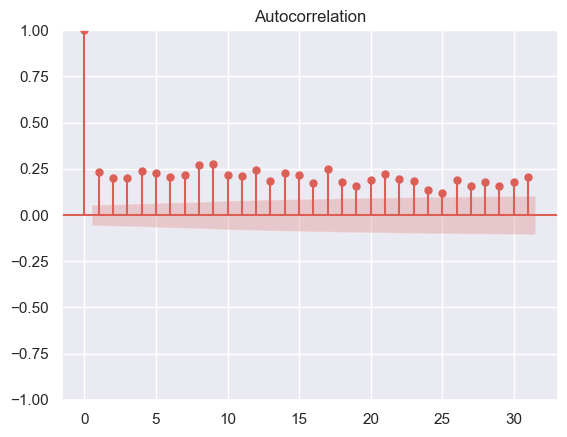

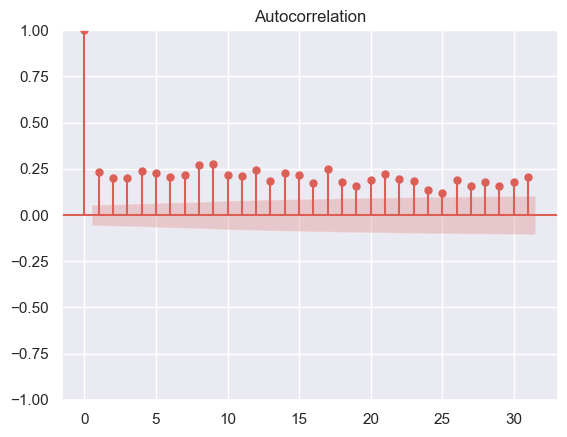

In [80]:
plot_acf(total_revenue["Total_Revenue"])

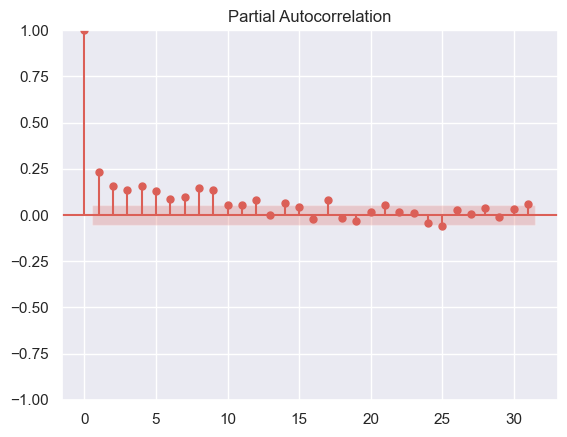

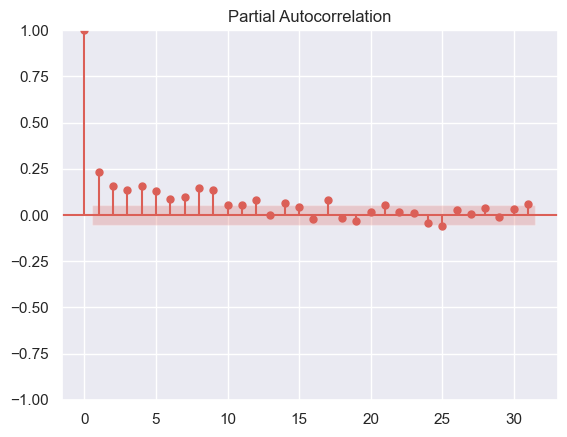

In [81]:
plot_pacf(total_revenue["Total_Revenue"])

In [82]:
model = SARIMAX(total_revenue["Total_Revenue"], order=(1,0,0)).fit()

In [83]:
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:          Total_Revenue   No. Observations:                 1224
Model:               SARIMAX(1, 0, 0)   Log Likelihood              -12192.908
Date:                Mon, 27 May 2024   AIC                          24389.817
Time:                        00:22:00   BIC                          24400.037
Sample:                             0   HQIC                         24393.663
                               - 1224                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.7186      0.016     46.309      0.000       0.688       0.749
sigma2      2.631e+07    5.6e-11   4.69e+17      0.000    2.63e+07    2.63e+07
===================================================================================
Ljung-Box (L1) (Q):                 229.09   Jarque-Bera (JB):               494.87
Prob(Q):                              0.00   Prob(JB):                         0.00
Heteroskedasticity (H):               3.67   Skew:                             0.71
Prob(H) (two-sided):                  0.00   Kurtosis:                         5.78
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

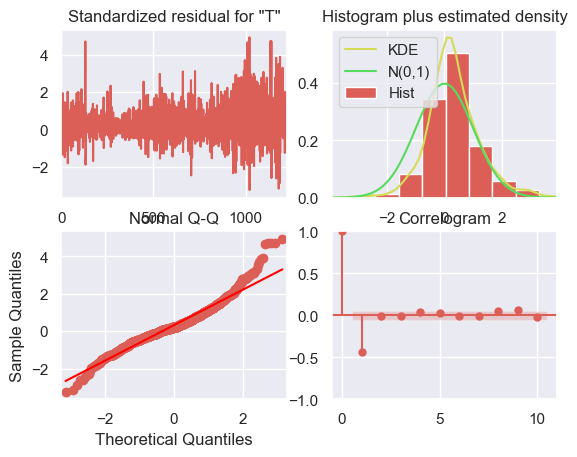

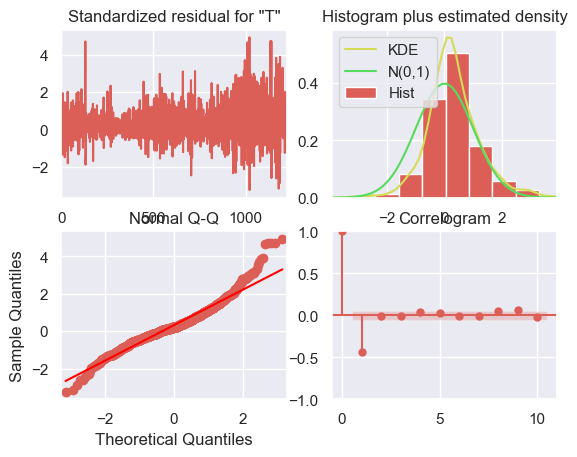

In [84]:
model.plot_diagnostics()

<span style="color: blue;">

### 4.3. One step ahead forecast <a class="anchor" id="14th-bullet"></a>

</span>

In [85]:
forecast_values = model.get_forecast(steps=1)

In [86]:
total_revenue.iloc[-10]

Date             2016-06-21
Total_Revenue         11938
Name: 1214, dtype: object

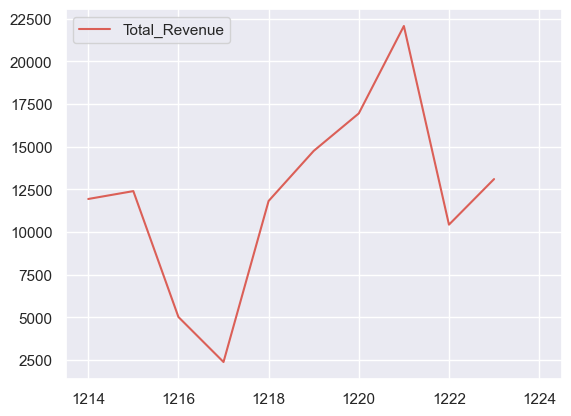

In [87]:
total_revenue.iloc[-10:].plot(y="Total_Revenue")
forecast_values.predicted_mean.plot();

In [88]:
forecast_values.predicted_mean

1224    9416.492237
dtype: float64

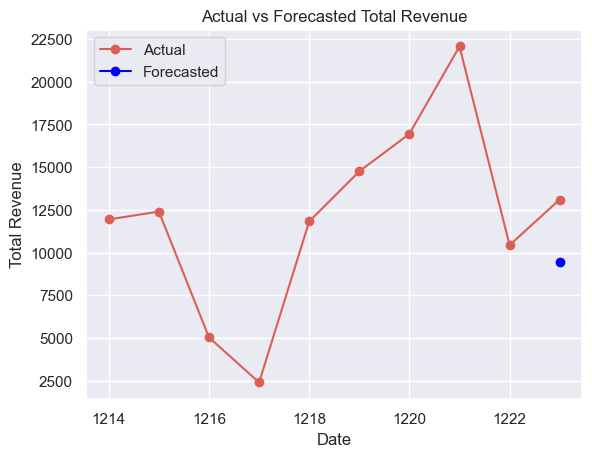

In [89]:
total_revenue.iloc[-10:].plot(y="Total_Revenue", marker="o", linestyle="-", label="Actual")

plt.plot(total_revenue.index[-1], forecast_values.predicted_mean, marker="o", color="blue", label="Forecasted")


plt.xlabel("Date")
plt.ylabel("Total Revenue")
plt.title("Actual vs Forecasted Total Revenue")
plt.legend()

plt.show()

In [90]:
forecasted_value = forecast_values.predicted_mean

actual_value = total_revenue.iloc[-1]["Total_Revenue"]

mae = mean_absolute_error([actual_value], [forecasted_value])

print("Mean Absolute Error (MAE):", mae)

Mean Absolute Error (MAE): 3687.507763414491


<span style="color: blue;">

## 5. Visualisations<a class="anchor" id="seventh-bullet"></a>

</span>

<span style="color: blue;">

### 5.1. Data Preparation for Visualisations <a class="anchor" id="11th-bullet"></a>

</span>

In [91]:
df.head()

,Date,Day,Month,Year,CustomerID,InvoiceID,Age,Age_Group,Gender,Country,State,Category,Sub_Category,Product,Quantity,Cost_Price,Selling_Price,Cost,Revenue,Profit
0,2013-10-22,22,October,2013,234568,141709,17,Youth (<25),F,Germany,Bayern,Accessories,Bottles and Cages,Water Bottle - 30 oz.,1,2,5,2,5,3
1,2013-10-22,22,October,2013,234568,141778,17,Youth (<25),F,Germany,Bayern,Accessories,Helmets,"Sport-100 Helmet, Black",18,13,35,234,624,390
2,2015-10-22,22,October,2015,234568,192232,17,Youth (<25),F,Germany,Bayern,Accessories,Bottles and Cages,Water Bottle - 30 oz.,1,2,5,2,5,3
3,2015-10-22,22,October,2015,234568,192278,17,Youth (<25),F,Germany,Bayern,Accessories,Helmets,"Sport-100 Helmet, Black",18,13,35,234,624,390
4,2013-12-31,31,December,2013,234569,151629,17,Youth (<25),F,Germany,Brandenburg,Accessories,Tires and Tubes,Patch Kit/8 Patches,13,1,2,13,26,13


In [92]:
df["Age_Group"].value_counts()

Adults (35-64)          55358
Young Adults (25-34)    38299
Youth (<25)             17660
Seniors (64+)             719
Name: Age_Group, dtype: int64

In [93]:
df["Category"].value_counts()

Accessories    69312
Bikes          25794
Clothing       16930
Name: Category, dtype: int64

In [94]:
df_modified = df

In [95]:
df_modified["Age_Group"] = df_modified["Age_Group"].replace("Youth (<25)", "Younger Adults (18-35)")
df_modified["Age_Group"] = df_modified["Age_Group"].replace("Young Adults (25-34)", "Younger Adults (18-35)")
df_modified["Age_Group"] = df_modified["Age_Group"].replace("Adults (35-64)", "Middle-aged Adults (36-64)")

In [96]:
df_modified.loc[df_modified["Age"] == 35, "Age_Group"] = "Younger Adults (18-35)"

In [97]:
df_modified["Age_Group"].value_counts()

Younger Adults (18-35)        59894
Middle-aged Adults (36-64)    51423
Seniors (64+)                   719
Name: Age_Group, dtype: int64

In [98]:
df_modified.head()

,Date,Day,Month,Year,CustomerID,InvoiceID,Age,Age_Group,Gender,Country,State,Category,Sub_Category,Product,Quantity,Cost_Price,Selling_Price,Cost,Revenue,Profit
0,2013-10-22,22,October,2013,234568,141709,17,Younger Adults (18-35),F,Germany,Bayern,Accessories,Bottles and Cages,Water Bottle - 30 oz.,1,2,5,2,5,3
1,2013-10-22,22,October,2013,234568,141778,17,Younger Adults (18-35),F,Germany,Bayern,Accessories,Helmets,"Sport-100 Helmet, Black",18,13,35,234,624,390
2,2015-10-22,22,October,2015,234568,192232,17,Younger Adults (18-35),F,Germany,Bayern,Accessories,Bottles and Cages,Water Bottle - 30 oz.,1,2,5,2,5,3
3,2015-10-22,22,October,2015,234568,192278,17,Younger Adults (18-35),F,Germany,Bayern,Accessories,Helmets,"Sport-100 Helmet, Black",18,13,35,234,624,390
4,2013-12-31,31,December,2013,234569,151629,17,Younger Adults (18-35),F,Germany,Brandenburg,Accessories,Tires and Tubes,Patch Kit/8 Patches,13,1,2,13,26,13


In [99]:
df_1835 = df_modified[df_modified['Age_Group'] == 'Younger Adults (18-35)']

In [100]:
df_1835.head()

,Date,Day,Month,Year,CustomerID,InvoiceID,Age,Age_Group,Gender,Country,State,Category,Sub_Category,Product,Quantity,Cost_Price,Selling_Price,Cost,Revenue,Profit
0,2013-10-22,22,October,2013,234568,141709,17,Younger Adults (18-35),F,Germany,Bayern,Accessories,Bottles and Cages,Water Bottle - 30 oz.,1,2,5,2,5,3
1,2013-10-22,22,October,2013,234568,141778,17,Younger Adults (18-35),F,Germany,Bayern,Accessories,Helmets,"Sport-100 Helmet, Black",18,13,35,234,624,390
2,2015-10-22,22,October,2015,234568,192232,17,Younger Adults (18-35),F,Germany,Bayern,Accessories,Bottles and Cages,Water Bottle - 30 oz.,1,2,5,2,5,3
3,2015-10-22,22,October,2015,234568,192278,17,Younger Adults (18-35),F,Germany,Bayern,Accessories,Helmets,"Sport-100 Helmet, Black",18,13,35,234,624,390
4,2013-12-31,31,December,2013,234569,151629,17,Younger Adults (18-35),F,Germany,Brandenburg,Accessories,Tires and Tubes,Patch Kit/8 Patches,13,1,2,13,26,13


In [101]:
revenue_1835 = df_1835.groupby(['Country', 'Year'])['Revenue'].sum().reset_index()

revenue_1835.head()

,Country,Year,Revenue
0,Australia,2011,1732675
1,Australia,2012,1741793
2,Australia,2013,2667878
3,Australia,2014,1312599
4,Australia,2015,3724624


<span style="color: blue;">

### 5.2. Visualisations used for Dashboard <a class="anchor" id="16th-bullet"></a>

</span>

Creating simple piechart, showing how customers are distributed accross different age groups. 

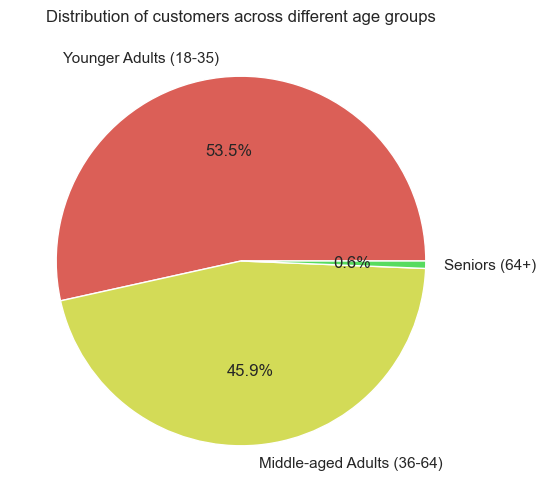

In [102]:
pn.extension("plotly")

age_group_counts = df_modified["Age_Group"].value_counts()
fig, ax = plt.subplots(figsize=(6, 6))
ax.pie(age_group_counts, labels=age_group_counts.index, autopct='%1.1f%%')
ax.set_title("Distribution of customers across different age groups")

pieplot = pn.pane.Matplotlib(fig, tight=True)

In [103]:
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b']

countries = df_modified["Country"].unique().tolist()

select_country = alt.binding_select(options=countries)
selector_widget = alt.selection_single(fields = ["Country"], bind = select_country, name="Select")

by_country_plot = alt.Chart(df_modified).mark_bar().encode(
    x=alt.X("Age_Group", axis=alt.Axis(labelFontSize=14, titleFontSize=16)), 
    y=alt.Y("count()", axis=alt.Axis(labelFontSize=14, titleFontSize=16)),
    color=alt.Color("Country", scale=alt.Scale(domain = countries, range=colors),
                   legend=alt.Legend(title="Country", titleFontSize=22, labelFontSize=18)),  
    tooltip=["Age_Group", "count()"]
).transform_filter(selector_widget).properties(
    title=alt.TitleParams(
        text="Age Group Distribution by Country",
        align="center",
        fontSize=20  
    ),
    width=600,
    height=400
).add_selection(selector_widget)

by_country_plot = by_country_plot.configure_axisX(
    labelFontSize=14,
    labelAngle=45
)
by_country_altair = pn.pane.Vega(by_country_plot)

by_country_plot

In [104]:
fig = px.choropleth(
    revenue_1835,
    locations="Country",
    locationmode="country names",
    color="Revenue",
    hover_name="Country",
    animation_frame="Year",  
    color_continuous_scale=px.colors.sequential.Plasma,
    title="Revenue Over the Years Worldwide")

fig1_dashboard = px.choropleth(
    revenue_1835,
    locations="Country",
    locationmode="country names",
    color="Revenue",
    hover_name="Country",
    animation_frame="Year",  
    color_continuous_scale=px.colors.sequential.Plasma,
    title="Revenue Over the Years Worldwide",
    width=1600, height=800)


fig.update_layout(
    width=1000, 
    height=700,  
    title_text='Revenue by Country and Year',  
    title_x=0.5) 

fig.show()

In [105]:
grouped_df = df_1835.groupby(["Year", "Category"]).agg({"Revenue": "sum"}).reset_index()

categories = ["Accessories", "Bikes", "Clothing"]
filtered_df = grouped_df[grouped_df['Category'].isin(categories)]

fig2 = px.line(filtered_df, x="Year", y="Revenue", color="Category", title="Revenue Over Years")
fig2_dashboard = px.line(filtered_df, x="Year", y="Revenue", color="Category", title="Revenue Over Years", width=1900, height=500)

fig2.show()

In [106]:
instagram = ['#F58529', '#DD2A7B', '#8134AF', '#515BD4']

In [107]:
heatmap = alt.Chart(df_1835).mark_rect().encode(
    alt.X("Sub_Category:N"),
    alt.Y("Quantity:Q", bin=True),
    alt.Color('count()',
        scale=alt.Scale(range=instagram),
        legend=alt.Legend(title='Totals')
    )
).properties(
    width=600
)

In [108]:
selected_category = alt.selection(type="single", encodings=['x'])

In [109]:
circles = heatmap.mark_point().encode(
    alt.ColorValue('grey'),
    alt.Size('count()',
        scale=alt.Scale(domain=(1, 600), range=(1, 200)),
        legend=alt.Legend(title="Category picked")
    )
).transform_filter(
    selected_category
)


In [110]:
bars = alt.Chart(df_1835).mark_bar().encode(
    x='Category:N',
    y='count()',
    color=alt.condition(selected_category, alt.ColorValue("orange"), alt.ColorValue("grey"))
).properties(
    width=200
).add_selection(selected_category)

In [111]:
heatmap + circles | bars

In [112]:
heatmap_dash = alt.Chart(df_1835).mark_rect().encode(
    alt.X('Sub_Category:N'),
    alt.Y('Quantity:Q', bin=True),
    alt.Color('count()',
        scale=alt.Scale(range=instagram),
        legend=alt.Legend(title='Totals')
    )
).properties(width=880, height=500)

circles_dash = heatmap.mark_point().encode(
    alt.ColorValue('grey'),
    alt.Size('count()',
        scale=alt.Scale(domain=(1, 600), range=(1, 200)),
        legend=alt.Legend(title="Category picked")
    )
).transform_filter(
    selected_category)


bars_dash = alt.Chart(df_1835).mark_bar().encode(
    x='Category:N',
    y='count()',
    color=alt.condition(selected_category, alt.ColorValue("orange"), alt.ColorValue("grey"))
).properties(
    width=880, height=500
).add_selection(selected_category)

heatmap + circles | bars

alt.HConcatChart(...)

In [113]:
fig3 = px.sunburst(df_1835, path=["Category", "Sub_Category", "Product"], values="Quantity", color="Category",
                   color_discrete_sequence=px.colors.qualitative.G10)
fig3.update_layout(title_text="Products Sunburst Diagram", font_size=16,
                   height=1000, width=800) 

fig3.show()

<span style="color: blue;">

## 6. Dashboard <a class="anchor" id="15th-bullet"></a>

</span>

In [114]:
dashboard = pn.Column(
    pn.pane.Markdown('<div style="padding: 10px; width:1900px; text-align: center;"><span style="display: block; color: black; font-size: 24px; text-align: right; font-weight: bold; text-shadow: 2px 2px 4px #999999;">Data Visualisation<br><br></span><span style="display: block; color: black; text-align: right; font-weight: bold; text-shadow: 2px 2px 4px #999999;">Zygimantas Jakubauskas<br></span></div>'),
    pn.pane.Markdown('<div style="padding: 10px; margin: 0px; width:1900px; text-align: center;"><span style="color: black; font-weight:bold; font-size:30px; text-shadow: 2px 2px 4px #999999;">Online Retailer Analysis Dashboard</span></div>', align='center'),
    pn.pane.Markdown('<div style="padding: 10px; margin: 0px; width:1900px; text-align: center; background-color: #f0f0f0;"><span style="color: black; font-weight:bold; font-size:24px;">About dataset</span></div>', align='center'),
    pn.pane.Markdown('<div style="padding: 10px; margin: 0px; width:1900px; text-align: justify;"><span style="color: black; font-weight:bold; font-size:16px;">Analysis of online retailer of bicycles and their accessories focusing on customers group aging 18-35.</span></div>', align='center'),
    pn.pane.Markdown('<div style="padding: 10px; width:1900px; text-align: center; background-color: #f0f0f0;"><span style="color: black; font-weight:bold; font-size:24px;">Distribution of customers age groups</span></div>', align='center'),
    pn.Row(pieplot, by_country_altair),
    pn.pane.Markdown('<div style="padding: 10px; width:1900px; text-align: center; background-color: #f0f0f0;"><span style="color: black; font-weight:bold; font-size:24px;">Worldwide revenue over the years</span></div>', align='center'),
    pn.Row(pn.Column(fig1_dashboard)),
    pn.pane.Markdown('<div style="padding: 10px; width:1900px; text-align: center; background-color: #f0f0f0;"><span style="color: black; font-weight:bold; font-size:24px;">Sales across three categories</span></div>', align='center'),
    pn.Row(pn.Column(fig2_dashboard)),
    pn.pane.Markdown('<div style="padding: 10px; width:1900px; text-align: center; background-color: #f0f0f0;"><span style="color: black; font-weight:bold; font-size:24px;">Count of total quantities accross all categories</span></div>', align='center'),
    pn.Row(pn.Column(heatmap_dash + circles_dash | bars_dash)),
    pn.pane.Markdown('<div style="padding: 10px; width:1900px; text-align: center; background-color: #f0f0f0;"><span style="color: black; font-weight:bold; font-size:24px;">Sunburst Diagram</span></div>', align='center'),  
    pn.Row(pn.Column(fig3))
)

# Uncomment below to run dashboard within the Jupyter Notebook
# dashboard.servable()

# Uncomment any of below to serve dashboard in new window
pn.serve(dashboard.servable())
# dashboard.show()


Launching server at http://localhost:58543


<span style="color: blue;">

## References <a class="anchor" id="13th-bullet"></a>

</span>

https://www.kaggle.com/datasets/sadiqshah/bike-sales-in-europe